In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision.datasets import MNIST
from torchvision.transforms import transforms
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

In [2]:
# Hyperparameters
batch_size = 128
lr = 0.0002
z_dim = 100
image_size = 28*28
epochs = 50
device = torch.device('cpu')

In [3]:
# Data loading
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])
])
mnist = MNIST(root='./data', train=True, transform=transform, download=True)
dataloader = DataLoader(mnist, batch_size=batch_size, shuffle=True)

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|████████████████████████████████████████████████████████████████████| 9912422/9912422 [00:11<00:00, 880690.00it/s]


Extracting ./data\MNIST\raw\train-images-idx3-ubyte.gz to ./data\MNIST\raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|████████████████████████████████████████████████████████████████████████| 28881/28881 [00:00<00:00, 115241.88it/s]


Extracting ./data\MNIST\raw\train-labels-idx1-ubyte.gz to ./data\MNIST\raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|████████████████████████████████████████████████████████████████████| 1648877/1648877 [00:02<00:00, 593475.27it/s]


Extracting ./data\MNIST\raw\t10k-images-idx3-ubyte.gz to ./data\MNIST\raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████████████████████████████████████████████████████████████████████████████████| 4542/4542 [00:00<?, ?it/s]

Extracting ./data\MNIST\raw\t10k-labels-idx1-ubyte.gz to ./data\MNIST\raw



In [4]:
# Generator
class Generator(nn.Module):
    def __init__(self, z_dim):
        super(Generator, self).__init__()
        self.gen = nn.Sequential(
            nn.Linear(z_dim, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(True),
            nn.Linear(256, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(True),
            nn.Linear(512, 1024),
            nn.BatchNorm1d(1024),
            nn.ReLU(True),
            nn.Linear(1024, image_size),
            nn.Tanh()
        )

    def forward(self, x):
        return self.gen(x)


In [5]:
# Discriminator
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.dis = nn.Sequential(
            nn.Linear(image_size, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.dis(x)

In [6]:
# Initialize models
G = Generator(z_dim).to(device)
D = Discriminator().to(device)

In [7]:
# Loss and optimizers
criterion = nn.BCELoss()
optimizer_G = optim.Adam(G.parameters(), lr=lr)
optimizer_D = optim.Adam(D.parameters(), lr=lr)

In [11]:
def train():
    G.train()
    D.train()
    
    for epoch in range(epochs):
        for i, (imgs, _) in enumerate(dataloader):
            # Prepare real and fake data
            real_imgs = imgs.view(imgs.size(0), -1).to(device)
            real_labels = torch.ones(imgs.size(0), 1).to(device)
            fake_labels = torch.zeros(imgs.size(0), 1).to(device)

            # Train Discriminator
            z = torch.randn(imgs.size(0), z_dim).to(device)
            fake_imgs = G(z)
            
            real_loss = criterion(D(real_imgs), real_labels)
            fake_loss = criterion(D(fake_imgs.detach()), fake_labels)
            d_loss = real_loss + fake_loss
            
            optimizer_D.zero_grad()
            d_loss.backward()
            optimizer_D.step()
            
            # Train Generator
            g_loss = criterion(D(fake_imgs), real_labels)
            
            optimizer_G.zero_grad()
            g_loss.backward()
            optimizer_G.step()
            
            if i % 100 == 0:
                print(f"Epoch [{epoch+1}/{epochs}] Batch [{i}/{len(dataloader)}] Loss D: {d_loss.item()}, loss G: {g_loss.item()}")
        # Visualization
        with torch.no_grad():
            z = torch.randn(batch_size, z_dim).to(device)
            fake_imgs = G(z).view(-1, 1, 28, 28)
            real_imgs = real_imgs.view(-1, 1, 28, 28)
            
            fake_grid = make_grid(fake_imgs, nrow=12, normalize=True)
            real_grid = make_grid(real_imgs, nrow=12, normalize=True)
            
            plt.figure(figsize=(20, 10))
            
            plt.subplot(1, 2, 1)
            plt.title("Real Images")
            plt.imshow(real_grid.permute(1, 2, 0).cpu().numpy())
            
            plt.subplot(1, 2, 2)
            plt.title("Generated Images")
            plt.imshow(fake_grid.permute(1, 2, 0).cpu().numpy())
            
            plt.show()

Epoch [1/50] Batch [0/469] Loss D: 0.5686677694320679, loss G: 2.081234931945801
Epoch [1/50] Batch [100/469] Loss D: 0.6930997967720032, loss G: 2.35782790184021
Epoch [1/50] Batch [200/469] Loss D: 0.5524060726165771, loss G: 2.2437050342559814
Epoch [1/50] Batch [300/469] Loss D: 0.6984208822250366, loss G: 1.9720494747161865
Epoch [1/50] Batch [400/469] Loss D: 0.6669999361038208, loss G: 1.8154938220977783


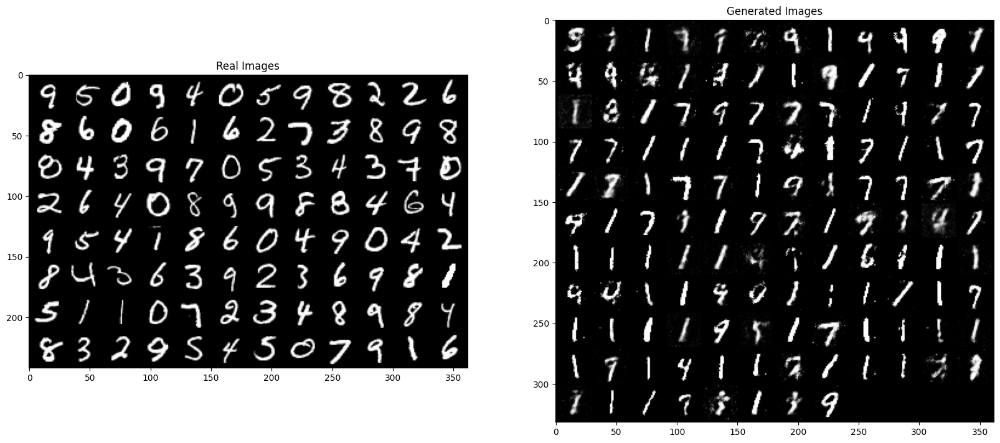

Epoch [2/50] Batch [0/469] Loss D: 0.6082273721694946, loss G: 1.9405362606048584
Epoch [2/50] Batch [100/469] Loss D: 0.6311575174331665, loss G: 2.338300943374634
Epoch [2/50] Batch [200/469] Loss D: 0.7933563590049744, loss G: 1.4974361658096313
Epoch [2/50] Batch [300/469] Loss D: 0.5285314917564392, loss G: 2.1289806365966797
Epoch [2/50] Batch [400/469] Loss D: 0.8627529144287109, loss G: 1.2377184629440308


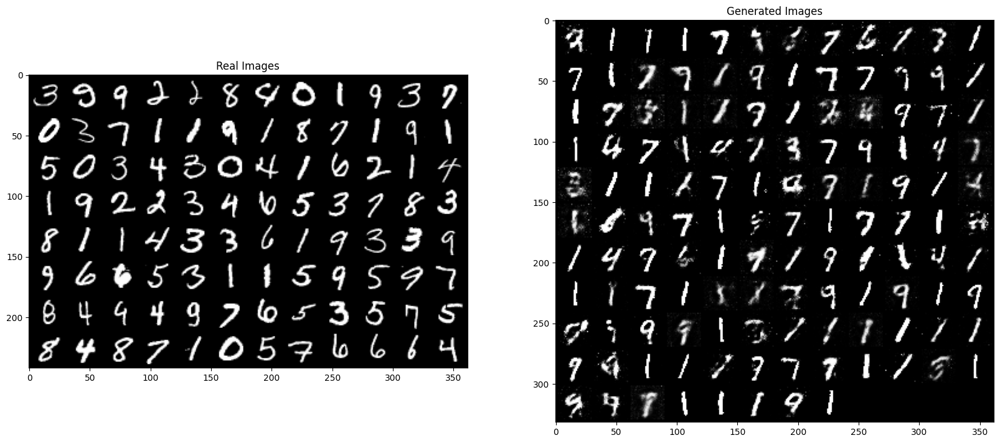

Epoch [3/50] Batch [0/469] Loss D: 0.8530798554420471, loss G: 1.6332893371582031
Epoch [3/50] Batch [100/469] Loss D: 0.7839099764823914, loss G: 1.305077075958252
Epoch [3/50] Batch [200/469] Loss D: 0.5604994297027588, loss G: 2.8916430473327637
Epoch [3/50] Batch [300/469] Loss D: 0.7805396914482117, loss G: 1.5016134977340698
Epoch [3/50] Batch [400/469] Loss D: 0.5684223175048828, loss G: 2.726654529571533


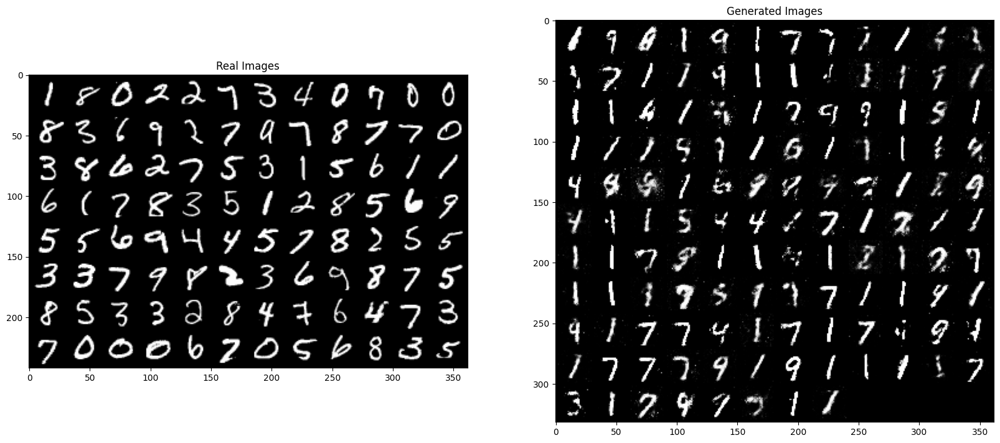

Epoch [4/50] Batch [0/469] Loss D: 0.5337132215499878, loss G: 1.9730663299560547
Epoch [4/50] Batch [100/469] Loss D: 0.5975995063781738, loss G: 2.2832226753234863
Epoch [4/50] Batch [200/469] Loss D: 0.787049412727356, loss G: 1.550545573234558
Epoch [4/50] Batch [300/469] Loss D: 0.6599549055099487, loss G: 1.7083032131195068
Epoch [4/50] Batch [400/469] Loss D: 0.8300580382347107, loss G: 1.4741030931472778


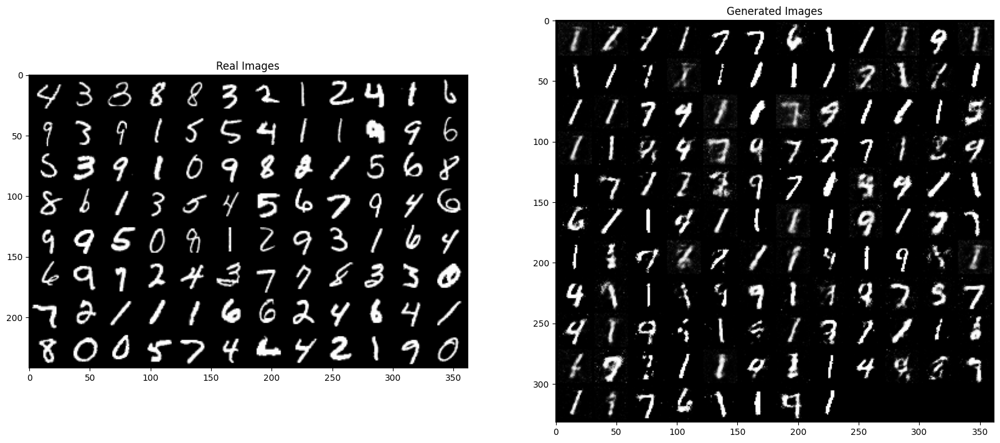

Epoch [5/50] Batch [0/469] Loss D: 0.8748668432235718, loss G: 1.687131643295288
Epoch [5/50] Batch [100/469] Loss D: 0.6204756498336792, loss G: 2.00996470451355
Epoch [5/50] Batch [200/469] Loss D: 0.7337472438812256, loss G: 1.7830256223678589
Epoch [5/50] Batch [300/469] Loss D: 0.5156512260437012, loss G: 2.0282201766967773
Epoch [5/50] Batch [400/469] Loss D: 0.7881420850753784, loss G: 1.1633048057556152


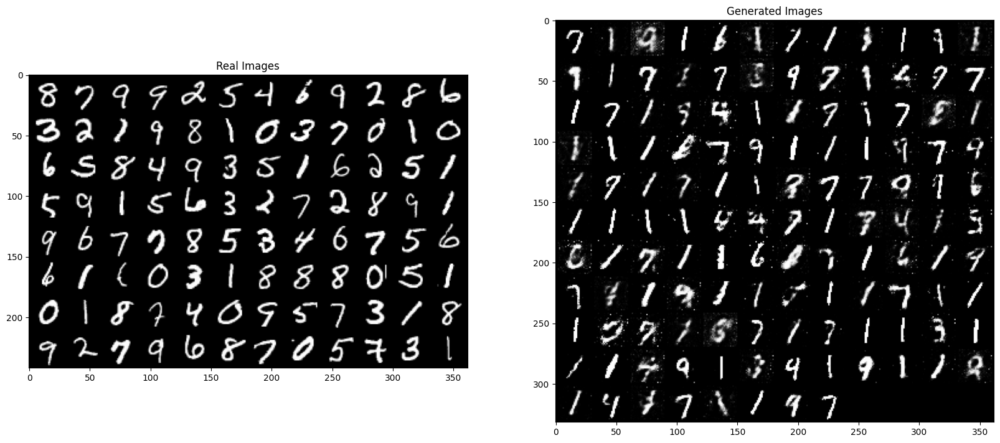

Epoch [6/50] Batch [0/469] Loss D: 0.8989756107330322, loss G: 1.4432482719421387
Epoch [6/50] Batch [100/469] Loss D: 0.6216212511062622, loss G: 1.7380218505859375
Epoch [6/50] Batch [200/469] Loss D: 0.6108505725860596, loss G: 2.834083080291748
Epoch [6/50] Batch [300/469] Loss D: 0.6992006301879883, loss G: 1.4450753927230835
Epoch [6/50] Batch [400/469] Loss D: 0.4746646583080292, loss G: 2.843662977218628


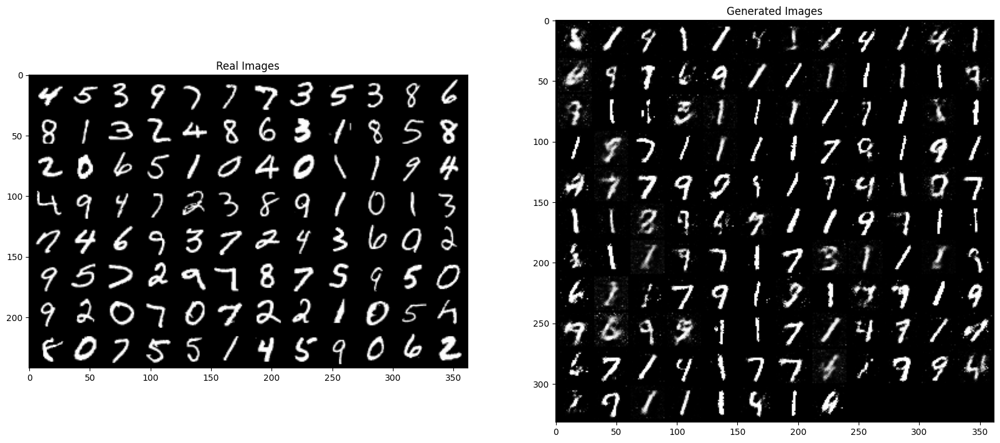

Epoch [7/50] Batch [0/469] Loss D: 0.7523230314254761, loss G: 2.0921523571014404
Epoch [7/50] Batch [100/469] Loss D: 0.51183021068573, loss G: 1.9828362464904785
Epoch [7/50] Batch [200/469] Loss D: 0.650853157043457, loss G: 1.816917061805725
Epoch [7/50] Batch [300/469] Loss D: 0.8804635405540466, loss G: 1.9985841512680054
Epoch [7/50] Batch [400/469] Loss D: 0.7464538812637329, loss G: 2.333094835281372


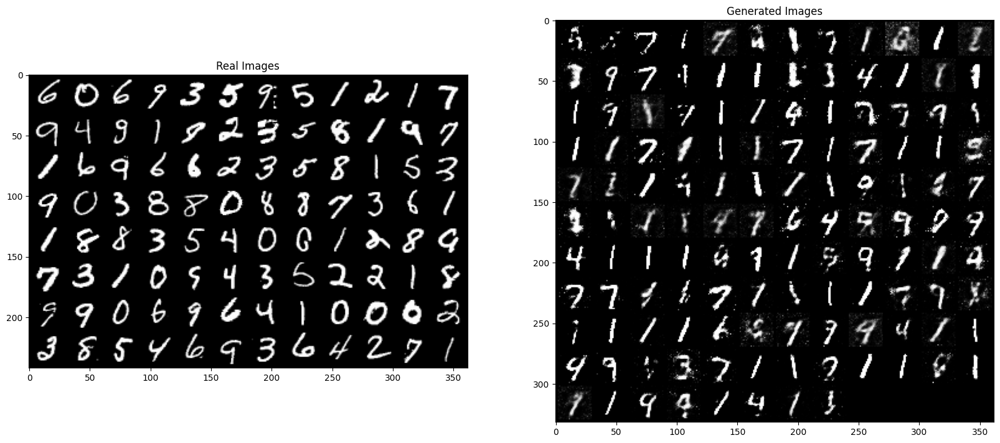

Epoch [8/50] Batch [0/469] Loss D: 0.6303030252456665, loss G: 1.7948439121246338
Epoch [8/50] Batch [100/469] Loss D: 0.7804908752441406, loss G: 2.264369010925293
Epoch [8/50] Batch [200/469] Loss D: 0.6085891723632812, loss G: 1.9800174236297607
Epoch [8/50] Batch [300/469] Loss D: 0.79371178150177, loss G: 2.196037530899048
Epoch [8/50] Batch [400/469] Loss D: 0.815767765045166, loss G: 1.9698479175567627


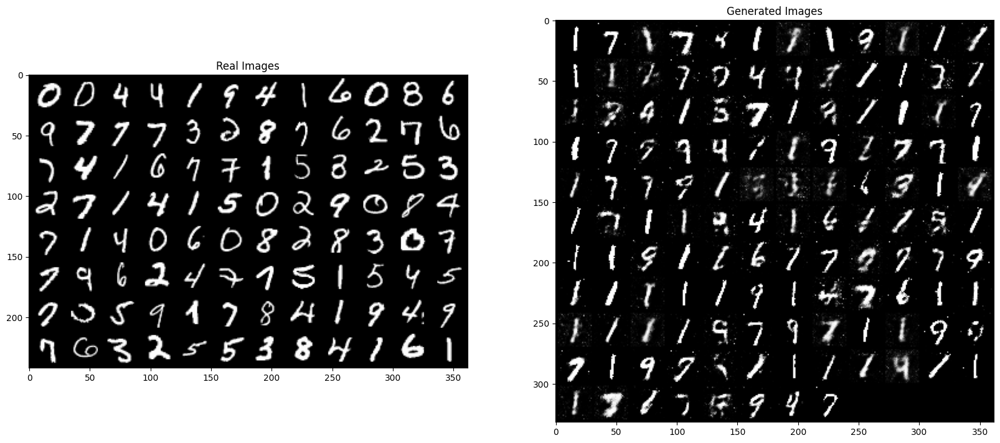

Epoch [9/50] Batch [0/469] Loss D: 0.7238503694534302, loss G: 1.8223239183425903
Epoch [9/50] Batch [100/469] Loss D: 0.689667284488678, loss G: 2.0589680671691895
Epoch [9/50] Batch [200/469] Loss D: 0.6137311458587646, loss G: 2.319450616836548
Epoch [9/50] Batch [300/469] Loss D: 0.6796125173568726, loss G: 1.5937230587005615
Epoch [9/50] Batch [400/469] Loss D: 0.6263135671615601, loss G: 1.7583661079406738


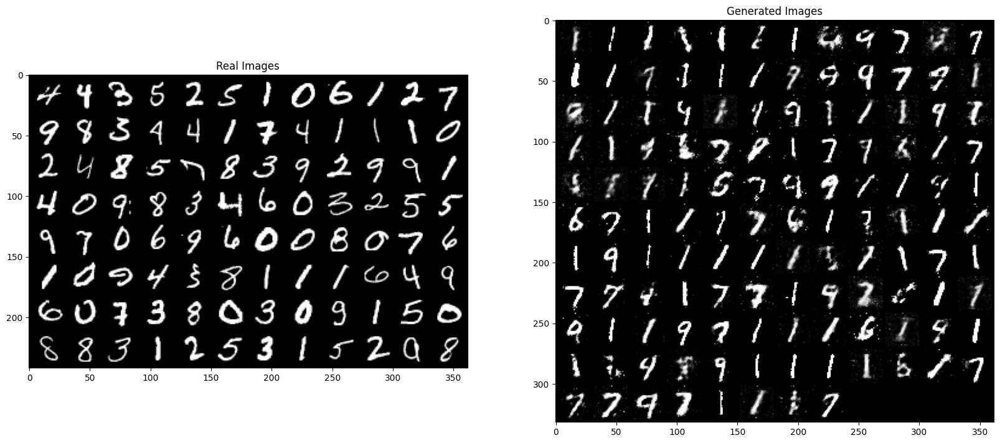

Epoch [10/50] Batch [0/469] Loss D: 0.8363907933235168, loss G: 1.5135377645492554
Epoch [10/50] Batch [100/469] Loss D: 0.6918278336524963, loss G: 1.8709158897399902
Epoch [10/50] Batch [200/469] Loss D: 0.6331512331962585, loss G: 2.383544921875
Epoch [10/50] Batch [300/469] Loss D: 0.8116732835769653, loss G: 1.9771883487701416
Epoch [10/50] Batch [400/469] Loss D: 0.5939458608627319, loss G: 1.8107943534851074


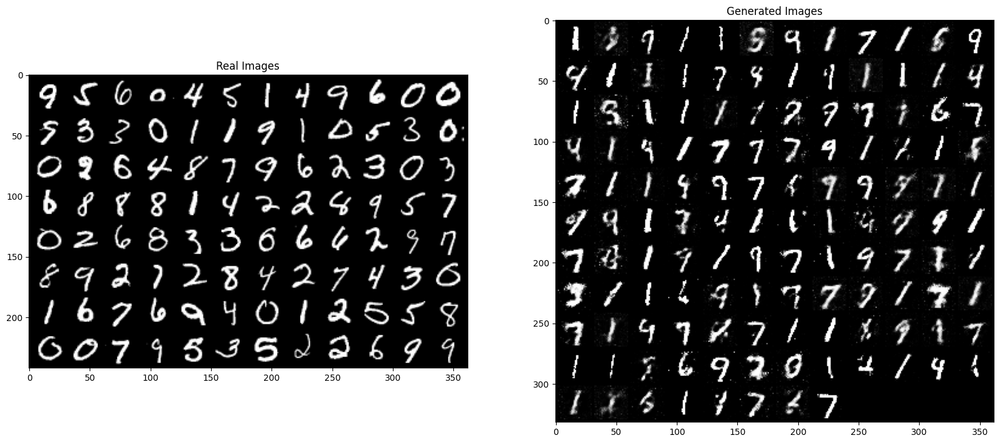

Epoch [11/50] Batch [0/469] Loss D: 0.6090205907821655, loss G: 2.433474540710449
Epoch [11/50] Batch [100/469] Loss D: 0.5793551206588745, loss G: 2.04935359954834
Epoch [11/50] Batch [200/469] Loss D: 0.6945766806602478, loss G: 1.8109493255615234
Epoch [11/50] Batch [300/469] Loss D: 0.7210772633552551, loss G: 1.627343773841858
Epoch [11/50] Batch [400/469] Loss D: 0.5595516562461853, loss G: 2.153249740600586


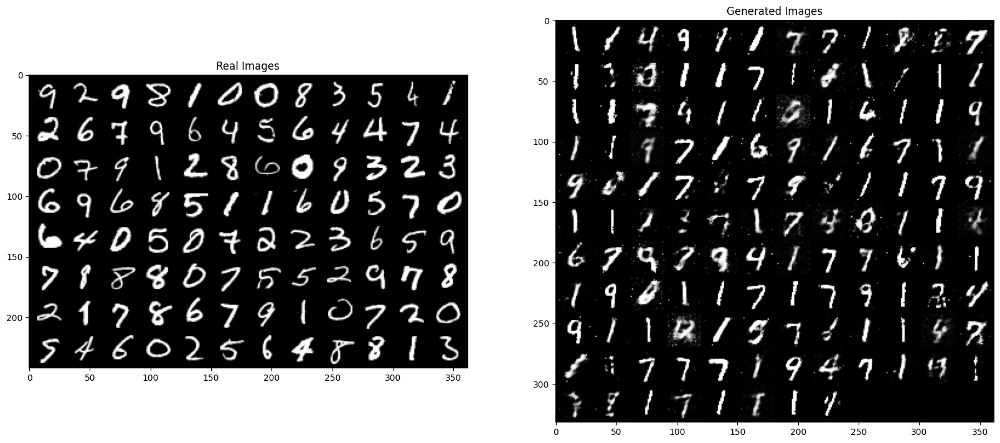

Epoch [12/50] Batch [0/469] Loss D: 0.7155523300170898, loss G: 1.5335835218429565
Epoch [12/50] Batch [100/469] Loss D: 0.8854304552078247, loss G: 1.6566760540008545
Epoch [12/50] Batch [200/469] Loss D: 0.7204177975654602, loss G: 1.5599708557128906
Epoch [12/50] Batch [300/469] Loss D: 0.8752739429473877, loss G: 1.3771129846572876
Epoch [12/50] Batch [400/469] Loss D: 0.9197872877120972, loss G: 1.2095279693603516


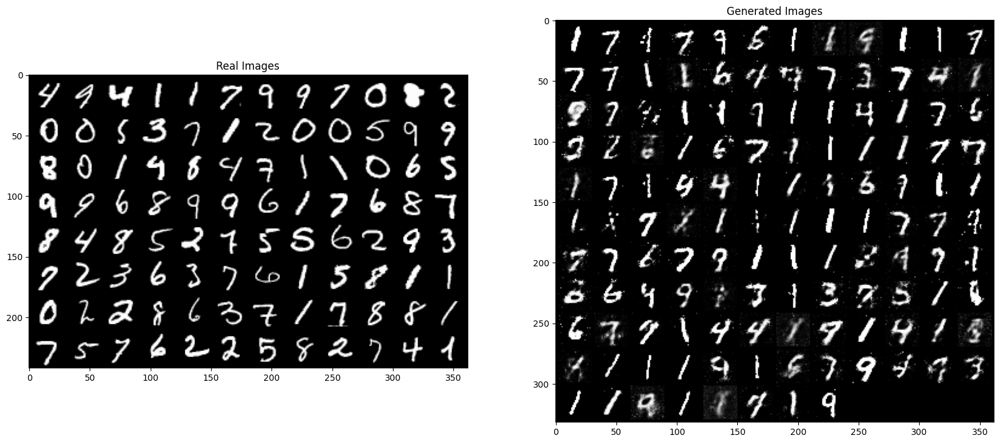

Epoch [13/50] Batch [0/469] Loss D: 0.9343869686126709, loss G: 1.7577868700027466
Epoch [13/50] Batch [100/469] Loss D: 0.5611490607261658, loss G: 2.343635320663452
Epoch [13/50] Batch [200/469] Loss D: 0.788175106048584, loss G: 1.8756787776947021
Epoch [13/50] Batch [300/469] Loss D: 0.7403945922851562, loss G: 2.093871593475342
Epoch [13/50] Batch [400/469] Loss D: 0.7006525993347168, loss G: 1.7882683277130127


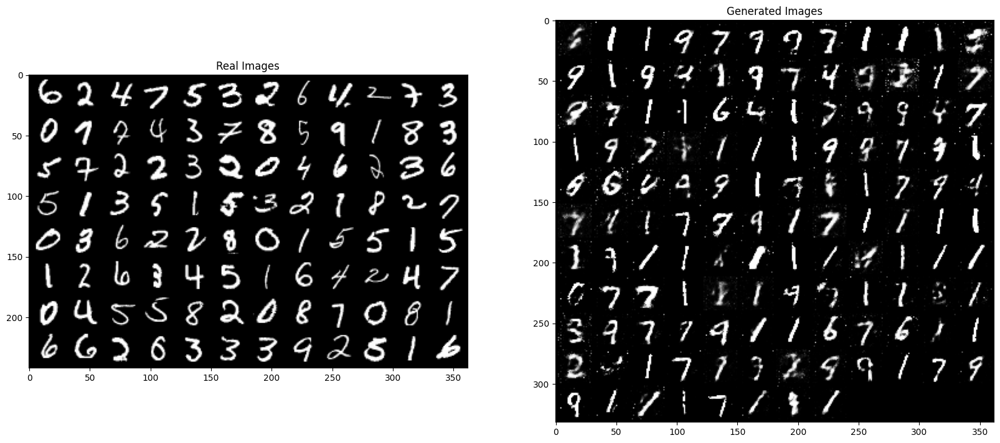

Epoch [14/50] Batch [0/469] Loss D: 0.8265504240989685, loss G: 1.5824213027954102
Epoch [14/50] Batch [100/469] Loss D: 0.861520528793335, loss G: 1.819161057472229
Epoch [14/50] Batch [200/469] Loss D: 0.8987597227096558, loss G: 1.4706213474273682
Epoch [14/50] Batch [300/469] Loss D: 0.7586684823036194, loss G: 1.461595058441162
Epoch [14/50] Batch [400/469] Loss D: 0.7443075180053711, loss G: 1.5261616706848145


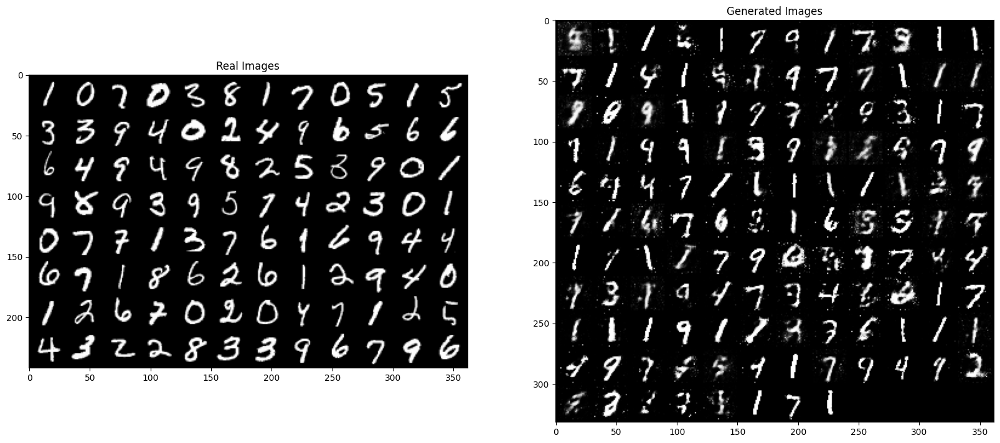

Epoch [15/50] Batch [0/469] Loss D: 0.8305379152297974, loss G: 1.9758591651916504
Epoch [15/50] Batch [100/469] Loss D: 0.8111376762390137, loss G: 1.52224600315094
Epoch [15/50] Batch [200/469] Loss D: 0.7488750219345093, loss G: 2.829967737197876
Epoch [15/50] Batch [300/469] Loss D: 0.6939570903778076, loss G: 2.1396114826202393
Epoch [15/50] Batch [400/469] Loss D: 0.5498273372650146, loss G: 3.063283920288086


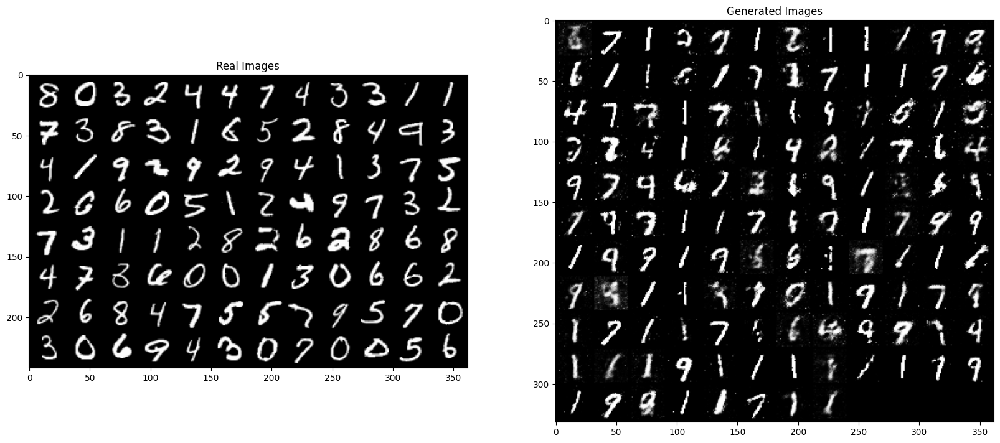

Epoch [16/50] Batch [0/469] Loss D: 0.7657821178436279, loss G: 2.2869739532470703
Epoch [16/50] Batch [100/469] Loss D: 0.8417842388153076, loss G: 1.7916104793548584
Epoch [16/50] Batch [200/469] Loss D: 0.7789437770843506, loss G: 2.079277515411377
Epoch [16/50] Batch [300/469] Loss D: 0.7814521193504333, loss G: 1.8418781757354736
Epoch [16/50] Batch [400/469] Loss D: 0.8409835696220398, loss G: 2.0297818183898926


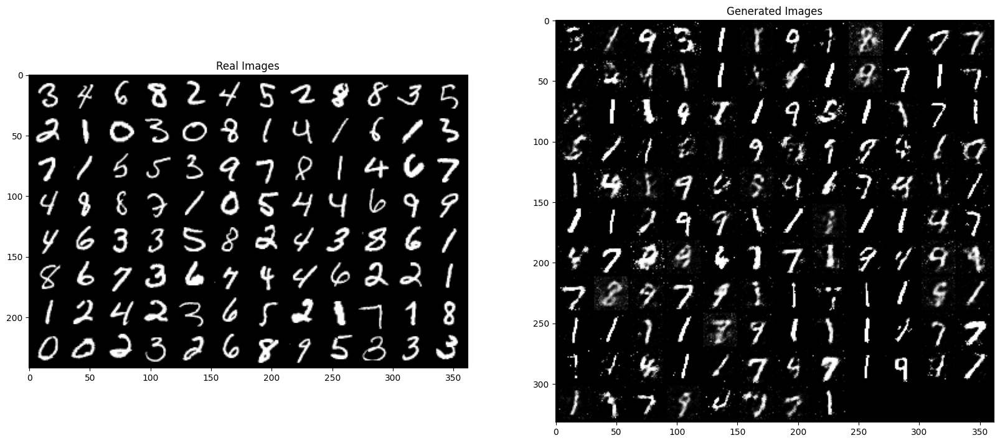

Epoch [17/50] Batch [0/469] Loss D: 0.9070293307304382, loss G: 1.3993388414382935
Epoch [17/50] Batch [100/469] Loss D: 0.6557961106300354, loss G: 1.8945837020874023
Epoch [17/50] Batch [200/469] Loss D: 0.7475796937942505, loss G: 1.4770351648330688
Epoch [17/50] Batch [300/469] Loss D: 0.6732068657875061, loss G: 1.7722207307815552
Epoch [17/50] Batch [400/469] Loss D: 0.7881693243980408, loss G: 1.7652242183685303


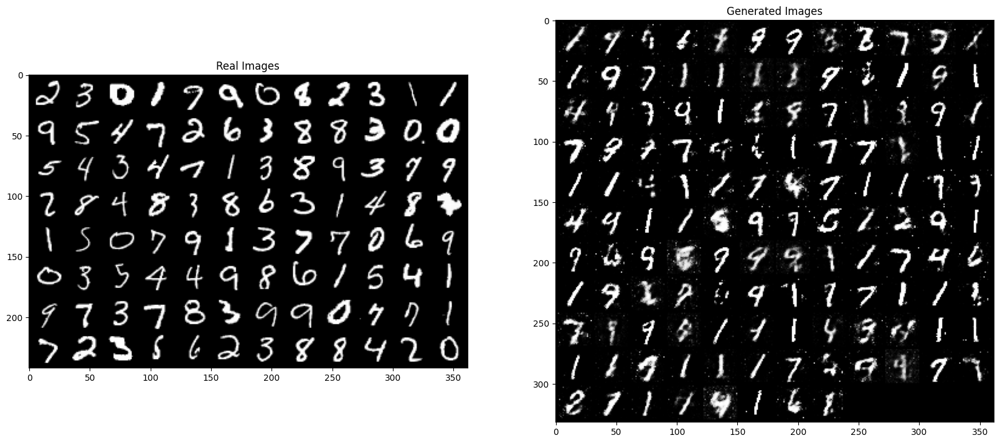

Epoch [18/50] Batch [0/469] Loss D: 0.7245715856552124, loss G: 1.4725135564804077
Epoch [18/50] Batch [100/469] Loss D: 0.48868054151535034, loss G: 3.0262675285339355
Epoch [18/50] Batch [200/469] Loss D: 0.7559400200843811, loss G: 1.3670217990875244
Epoch [18/50] Batch [300/469] Loss D: 0.8049208521842957, loss G: 1.7271050214767456
Epoch [18/50] Batch [400/469] Loss D: 0.5980790853500366, loss G: 1.7979880571365356


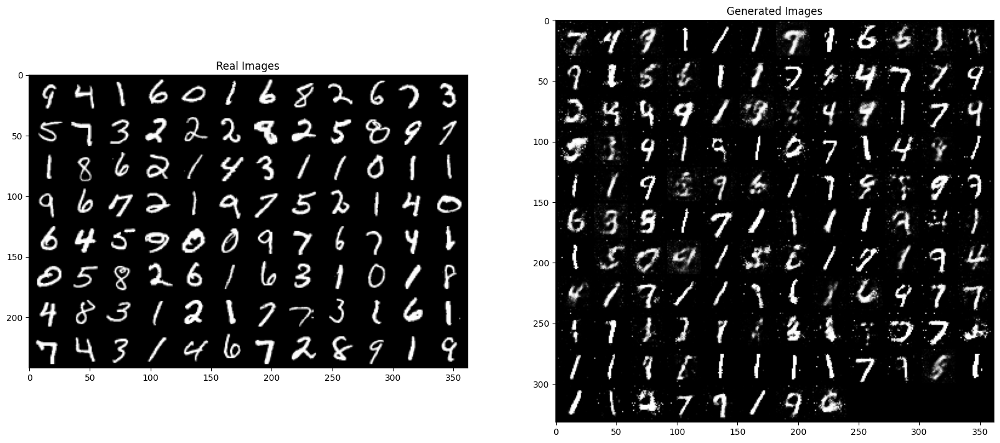

Epoch [19/50] Batch [0/469] Loss D: 0.833047091960907, loss G: 1.662158489227295
Epoch [19/50] Batch [100/469] Loss D: 0.6646689176559448, loss G: 1.814051628112793
Epoch [19/50] Batch [200/469] Loss D: 0.711318850517273, loss G: 1.5350149869918823
Epoch [19/50] Batch [300/469] Loss D: 0.6423077583312988, loss G: 1.9718399047851562
Epoch [19/50] Batch [400/469] Loss D: 0.6343579888343811, loss G: 1.6911683082580566


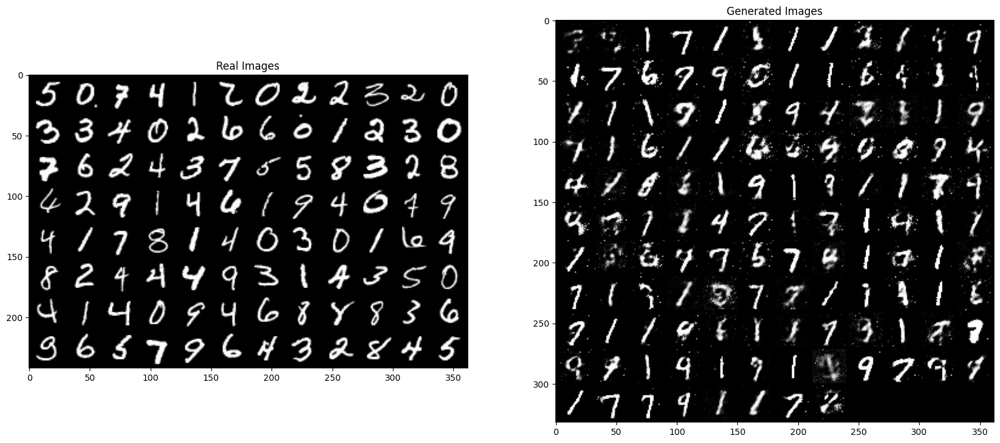

Epoch [20/50] Batch [0/469] Loss D: 0.7665858864784241, loss G: 1.6409800052642822
Epoch [20/50] Batch [100/469] Loss D: 1.0433080196380615, loss G: 1.486626386642456
Epoch [20/50] Batch [200/469] Loss D: 0.6563910245895386, loss G: 1.427087664604187
Epoch [20/50] Batch [300/469] Loss D: 0.7476575374603271, loss G: 2.2084851264953613
Epoch [20/50] Batch [400/469] Loss D: 0.8854662179946899, loss G: 1.5140769481658936


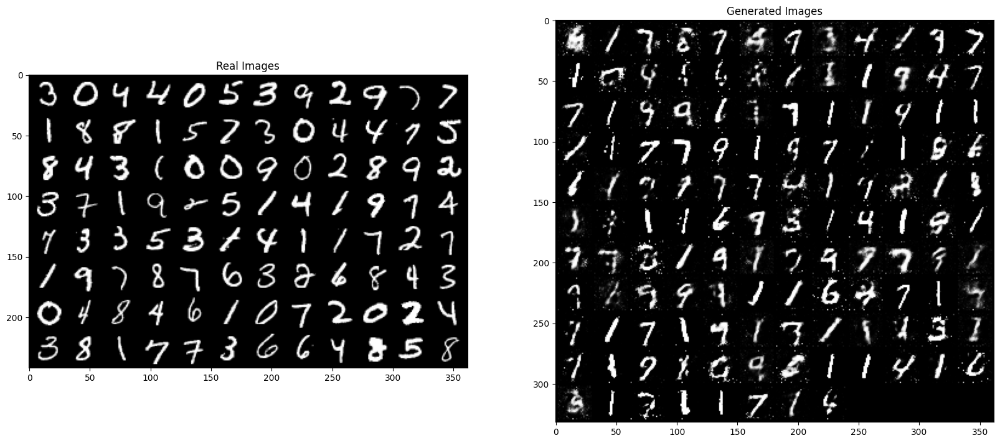

Epoch [21/50] Batch [0/469] Loss D: 0.9468493461608887, loss G: 1.6178048849105835
Epoch [21/50] Batch [100/469] Loss D: 0.777690052986145, loss G: 1.754698395729065
Epoch [21/50] Batch [200/469] Loss D: 0.7908302545547485, loss G: 1.5115300416946411
Epoch [21/50] Batch [300/469] Loss D: 1.0176515579223633, loss G: 1.1642155647277832
Epoch [21/50] Batch [400/469] Loss D: 0.5669684410095215, loss G: 2.355069637298584


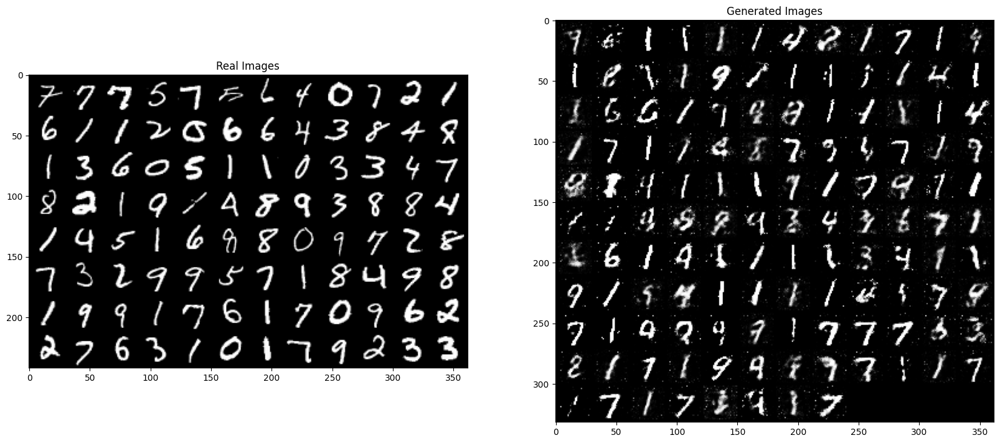

Epoch [22/50] Batch [0/469] Loss D: 0.6083735823631287, loss G: 3.1210591793060303
Epoch [22/50] Batch [100/469] Loss D: 0.7575938701629639, loss G: 1.6921547651290894
Epoch [22/50] Batch [200/469] Loss D: 0.657715916633606, loss G: 2.2681329250335693
Epoch [22/50] Batch [300/469] Loss D: 0.8605602383613586, loss G: 1.2650058269500732
Epoch [22/50] Batch [400/469] Loss D: 1.0376007556915283, loss G: 1.9082390069961548


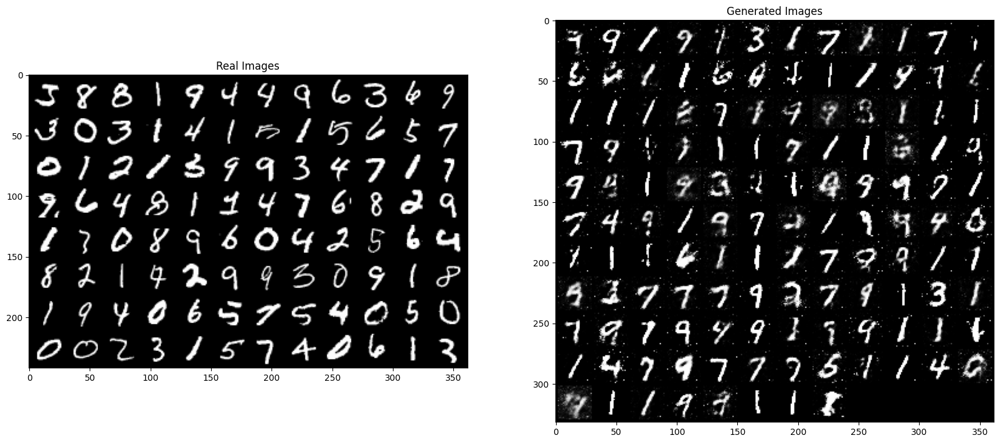

Epoch [23/50] Batch [0/469] Loss D: 0.8956713676452637, loss G: 2.1079041957855225
Epoch [23/50] Batch [100/469] Loss D: 0.9034316539764404, loss G: 1.2372806072235107
Epoch [23/50] Batch [200/469] Loss D: 0.7130513191223145, loss G: 1.4137274026870728
Epoch [23/50] Batch [300/469] Loss D: 0.9478623867034912, loss G: 1.4684271812438965
Epoch [23/50] Batch [400/469] Loss D: 0.725688099861145, loss G: 1.8511881828308105


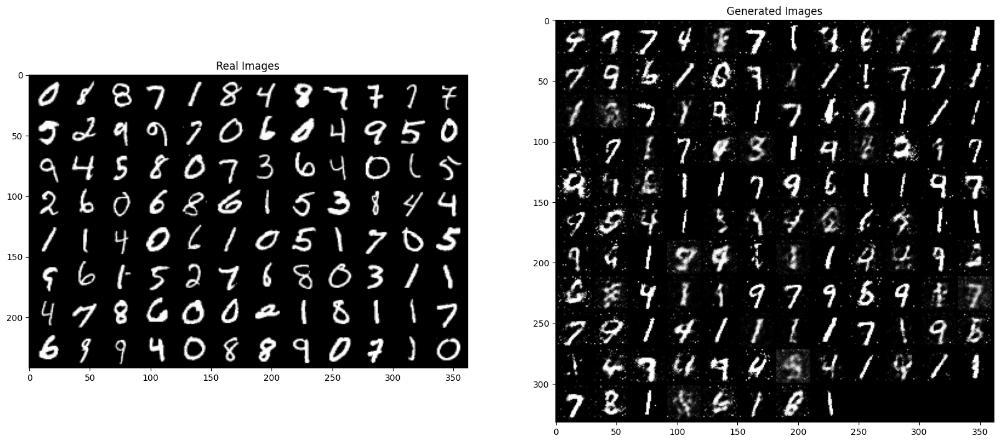

Epoch [24/50] Batch [0/469] Loss D: 0.8560901284217834, loss G: 1.5065929889678955
Epoch [24/50] Batch [100/469] Loss D: 0.6522634029388428, loss G: 1.6931023597717285
Epoch [24/50] Batch [200/469] Loss D: 0.6777962446212769, loss G: 1.6951395273208618
Epoch [24/50] Batch [300/469] Loss D: 0.6335790157318115, loss G: 2.092642307281494
Epoch [24/50] Batch [400/469] Loss D: 0.754298985004425, loss G: 1.7703081369400024


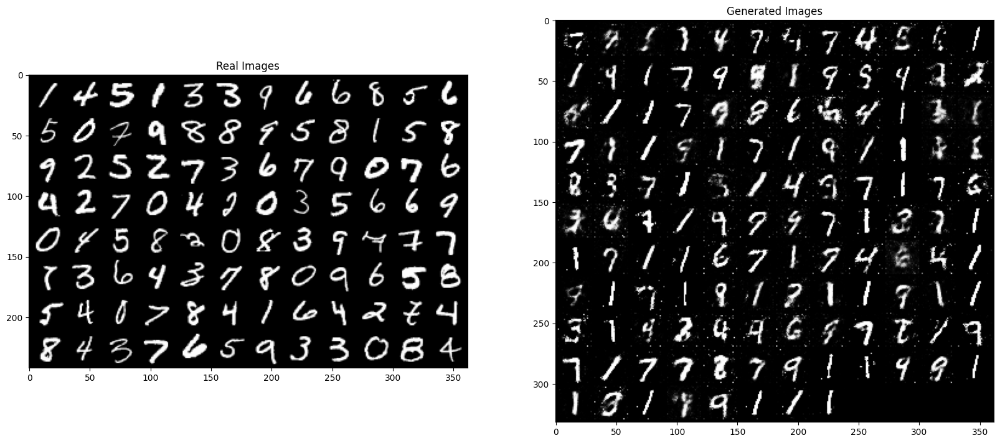

Epoch [25/50] Batch [0/469] Loss D: 0.7409656047821045, loss G: 1.7464845180511475
Epoch [25/50] Batch [100/469] Loss D: 0.8623979687690735, loss G: 1.5275027751922607
Epoch [25/50] Batch [200/469] Loss D: 0.8097895383834839, loss G: 1.304051399230957
Epoch [25/50] Batch [300/469] Loss D: 0.7690070867538452, loss G: 1.4458972215652466
Epoch [25/50] Batch [400/469] Loss D: 0.926645040512085, loss G: 1.5768673419952393


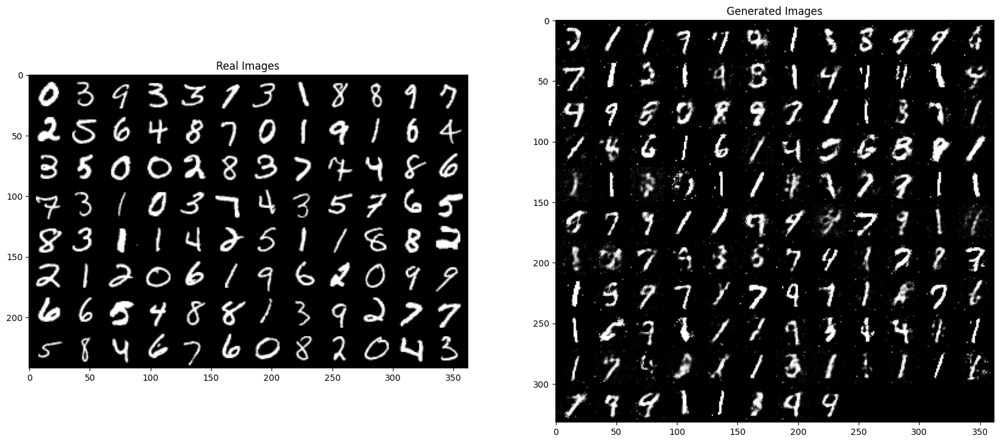

Epoch [26/50] Batch [0/469] Loss D: 0.775581955909729, loss G: 1.5104467868804932
Epoch [26/50] Batch [100/469] Loss D: 0.6585102081298828, loss G: 1.7401082515716553
Epoch [26/50] Batch [200/469] Loss D: 0.96468186378479, loss G: 1.8284404277801514
Epoch [26/50] Batch [300/469] Loss D: 0.4909658432006836, loss G: 2.7041876316070557
Epoch [26/50] Batch [400/469] Loss D: 0.7228298187255859, loss G: 1.879895567893982


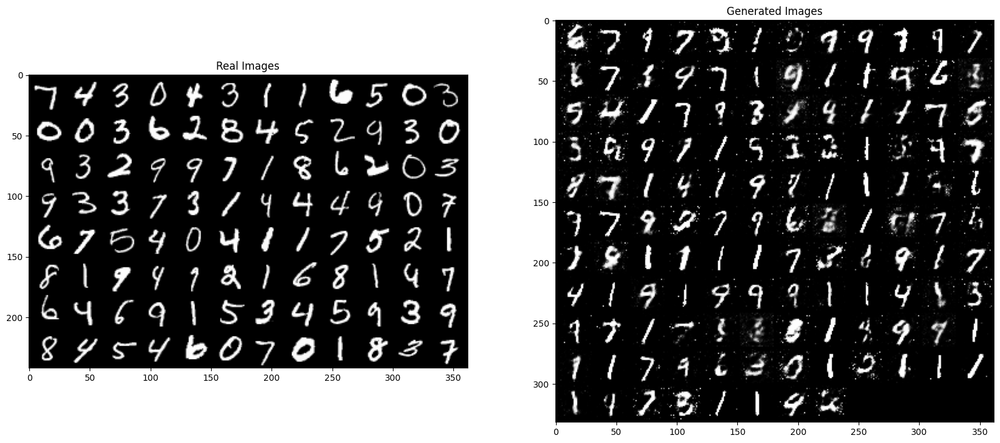

Epoch [27/50] Batch [0/469] Loss D: 0.9462817907333374, loss G: 1.7115764617919922
Epoch [27/50] Batch [100/469] Loss D: 0.8829014301300049, loss G: 1.334610939025879
Epoch [27/50] Batch [200/469] Loss D: 0.9982084035873413, loss G: 1.4209566116333008
Epoch [27/50] Batch [300/469] Loss D: 0.9139618873596191, loss G: 1.5727424621582031
Epoch [27/50] Batch [400/469] Loss D: 0.9875714778900146, loss G: 1.7887215614318848


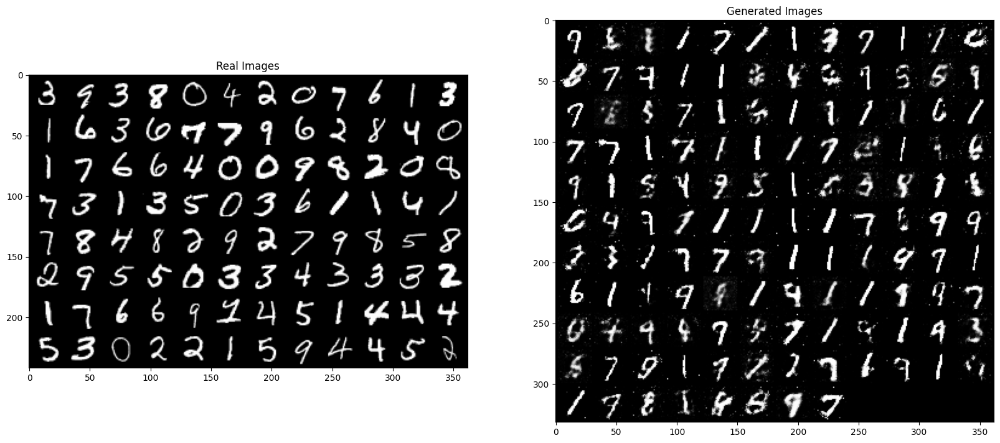

Epoch [28/50] Batch [0/469] Loss D: 1.3263603448867798, loss G: 1.106801986694336
Epoch [28/50] Batch [100/469] Loss D: 0.8649624586105347, loss G: 1.536703109741211
Epoch [28/50] Batch [200/469] Loss D: 0.6890932321548462, loss G: 2.8290748596191406
Epoch [28/50] Batch [300/469] Loss D: 0.8327121734619141, loss G: 1.4893814325332642
Epoch [28/50] Batch [400/469] Loss D: 0.9477896690368652, loss G: 1.5818448066711426


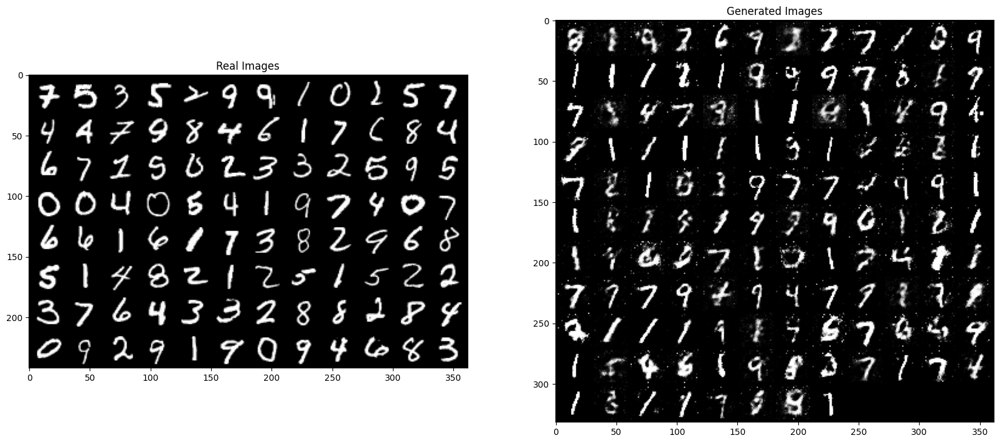

Epoch [29/50] Batch [0/469] Loss D: 0.8642425537109375, loss G: 1.626076579093933
Epoch [29/50] Batch [100/469] Loss D: 0.829573392868042, loss G: 2.202385663986206
Epoch [29/50] Batch [200/469] Loss D: 0.9790877103805542, loss G: 1.2361712455749512
Epoch [29/50] Batch [300/469] Loss D: 0.8098284602165222, loss G: 2.0104079246520996
Epoch [29/50] Batch [400/469] Loss D: 0.906342089176178, loss G: 1.6689786911010742


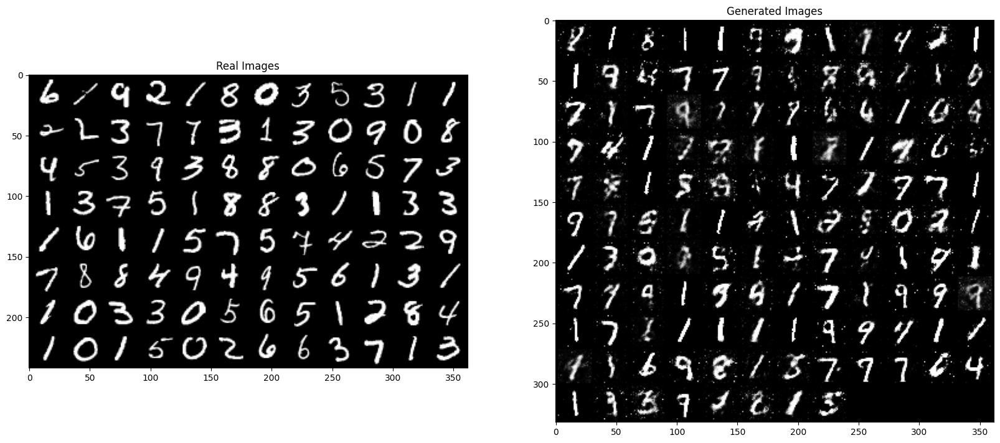

Epoch [30/50] Batch [0/469] Loss D: 0.6926342248916626, loss G: 2.268550395965576
Epoch [30/50] Batch [100/469] Loss D: 0.7359273433685303, loss G: 1.7134145498275757
Epoch [30/50] Batch [200/469] Loss D: 0.8609219789505005, loss G: 1.5797672271728516
Epoch [30/50] Batch [300/469] Loss D: 0.8615803718566895, loss G: 1.5498836040496826
Epoch [30/50] Batch [400/469] Loss D: 0.805317223072052, loss G: 1.7324599027633667


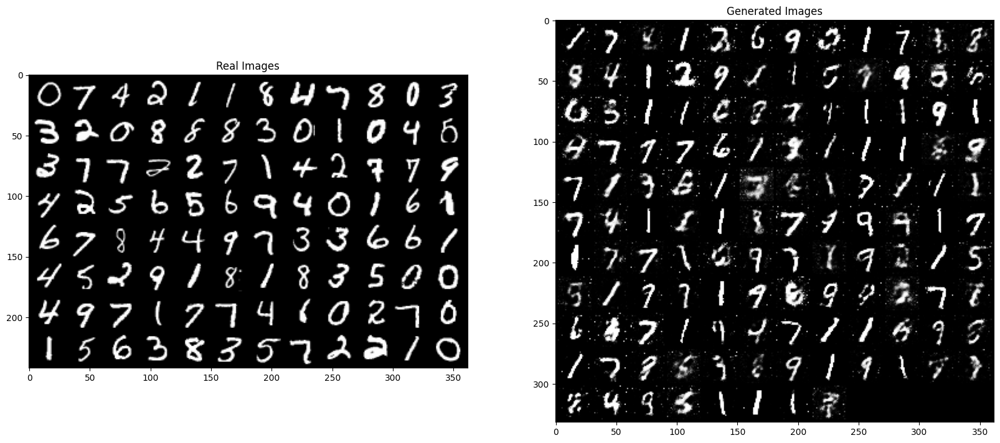

Epoch [31/50] Batch [0/469] Loss D: 0.7392066717147827, loss G: 1.87359619140625
Epoch [31/50] Batch [100/469] Loss D: 0.7398040294647217, loss G: 1.8923957347869873
Epoch [31/50] Batch [200/469] Loss D: 0.8773860931396484, loss G: 1.6953363418579102
Epoch [31/50] Batch [300/469] Loss D: 0.6355339884757996, loss G: 1.610687494277954
Epoch [31/50] Batch [400/469] Loss D: 0.784095287322998, loss G: 1.7483251094818115


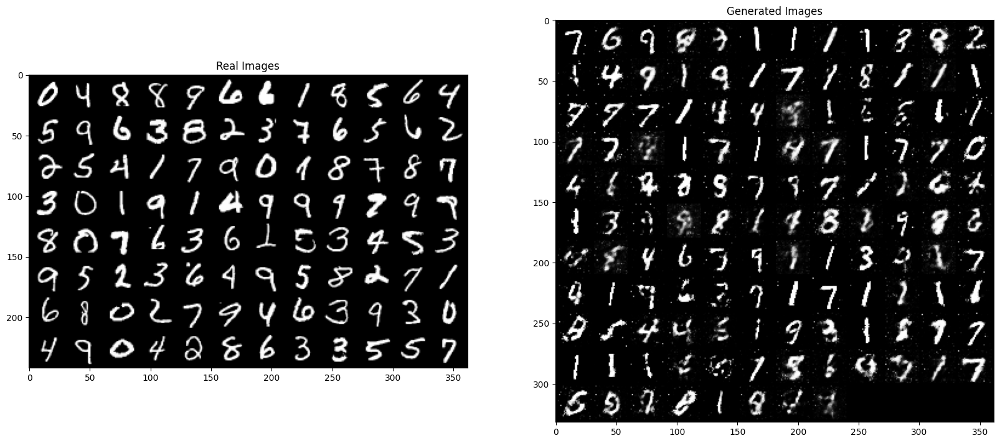

Epoch [32/50] Batch [0/469] Loss D: 1.007648229598999, loss G: 1.4241771697998047
Epoch [32/50] Batch [100/469] Loss D: 1.0575566291809082, loss G: 1.6117329597473145
Epoch [32/50] Batch [200/469] Loss D: 0.7252559661865234, loss G: 1.819228172302246
Epoch [32/50] Batch [300/469] Loss D: 0.9320904016494751, loss G: 1.5433183908462524
Epoch [32/50] Batch [400/469] Loss D: 0.9681891798973083, loss G: 2.1854429244995117


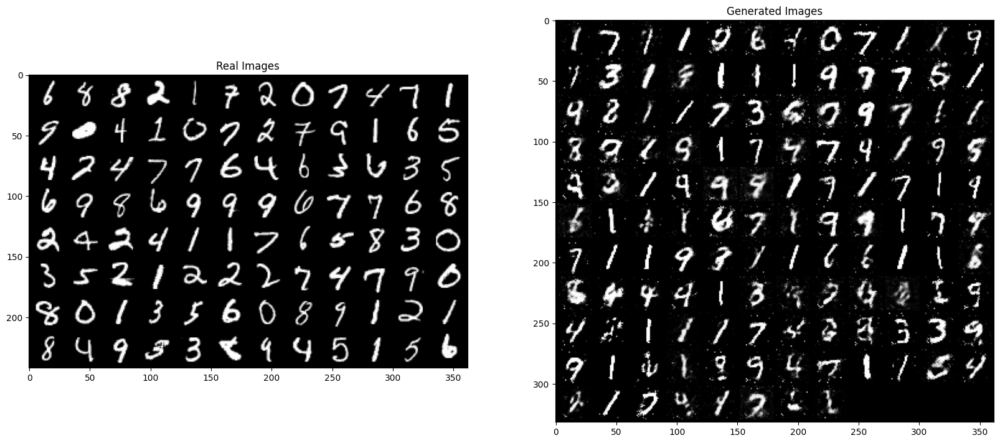

Epoch [33/50] Batch [0/469] Loss D: 1.0118794441223145, loss G: 1.3906588554382324
Epoch [33/50] Batch [100/469] Loss D: 1.1995660066604614, loss G: 1.3841289281845093
Epoch [33/50] Batch [200/469] Loss D: 1.0639945268630981, loss G: 1.4747183322906494
Epoch [33/50] Batch [300/469] Loss D: 0.8577402830123901, loss G: 1.7237976789474487
Epoch [33/50] Batch [400/469] Loss D: 0.8506375551223755, loss G: 1.4898687601089478


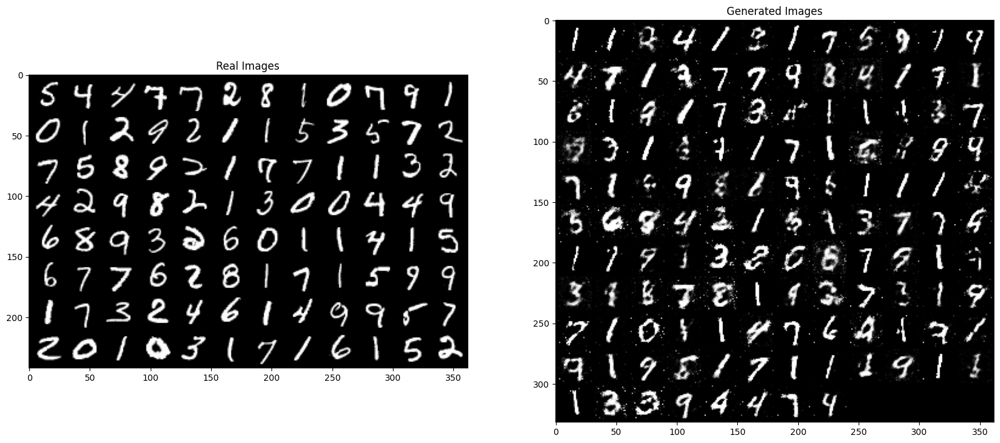

Epoch [34/50] Batch [0/469] Loss D: 0.8344476222991943, loss G: 2.0729236602783203
Epoch [34/50] Batch [100/469] Loss D: 0.6308846473693848, loss G: 2.0464866161346436
Epoch [34/50] Batch [200/469] Loss D: 0.713435173034668, loss G: 2.2406489849090576
Epoch [34/50] Batch [300/469] Loss D: 0.9375661015510559, loss G: 1.742510437965393
Epoch [34/50] Batch [400/469] Loss D: 0.559499979019165, loss G: 2.152320384979248


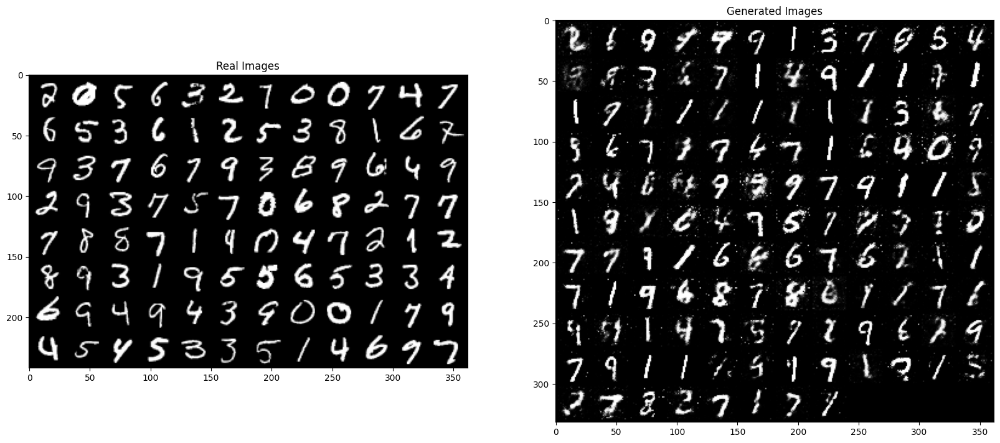

Epoch [35/50] Batch [0/469] Loss D: 0.8790395259857178, loss G: 1.5639516115188599
Epoch [35/50] Batch [100/469] Loss D: 1.0040889978408813, loss G: 1.431723952293396
Epoch [35/50] Batch [200/469] Loss D: 0.7916191816329956, loss G: 1.6896661520004272
Epoch [35/50] Batch [300/469] Loss D: 1.015231966972351, loss G: 1.6973633766174316
Epoch [35/50] Batch [400/469] Loss D: 0.7039949893951416, loss G: 1.7026265859603882


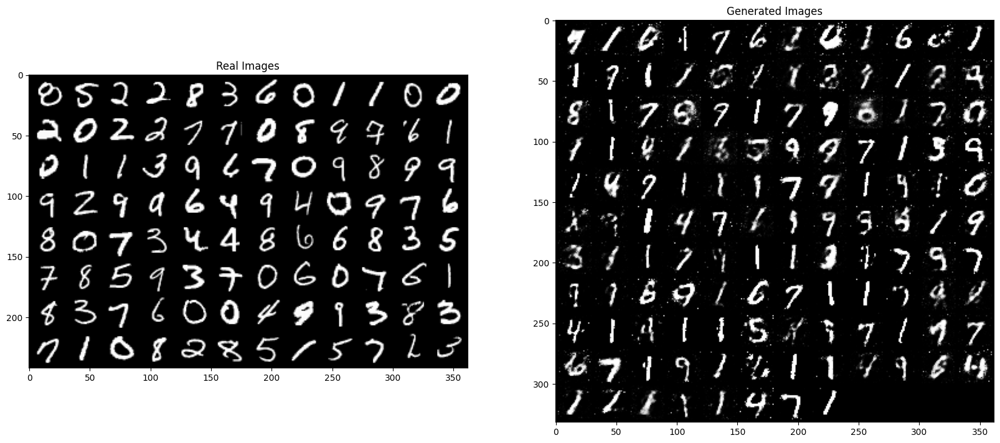

Epoch [36/50] Batch [0/469] Loss D: 1.123498797416687, loss G: 1.2417901754379272
Epoch [36/50] Batch [100/469] Loss D: 0.9010565280914307, loss G: 1.4335910081863403
Epoch [36/50] Batch [200/469] Loss D: 0.9452586770057678, loss G: 1.7142170667648315
Epoch [36/50] Batch [300/469] Loss D: 1.1830122470855713, loss G: 1.154253602027893
Epoch [36/50] Batch [400/469] Loss D: 0.8172801733016968, loss G: 1.7260525226593018


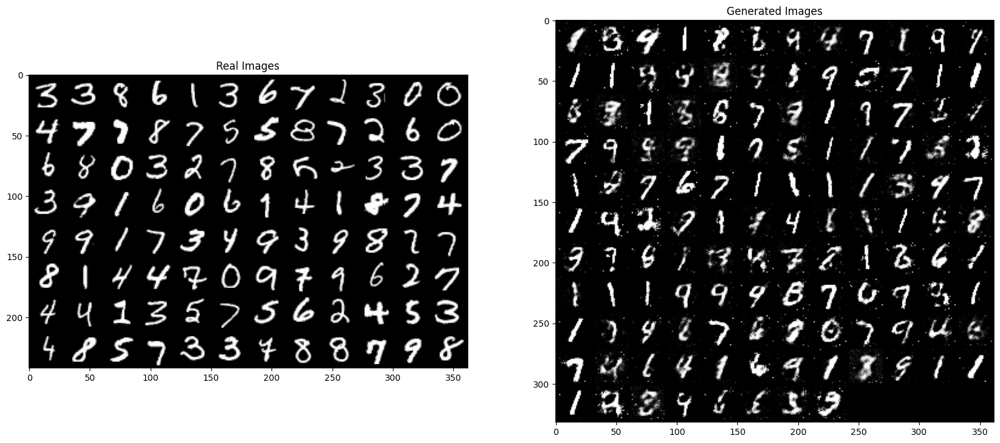

Epoch [37/50] Batch [0/469] Loss D: 0.6363946199417114, loss G: 2.1241061687469482
Epoch [37/50] Batch [100/469] Loss D: 0.825718343257904, loss G: 1.6102302074432373
Epoch [37/50] Batch [200/469] Loss D: 0.9490153789520264, loss G: 1.623018741607666
Epoch [37/50] Batch [300/469] Loss D: 0.8148419260978699, loss G: 2.118401527404785
Epoch [37/50] Batch [400/469] Loss D: 1.038649559020996, loss G: 1.7259033918380737


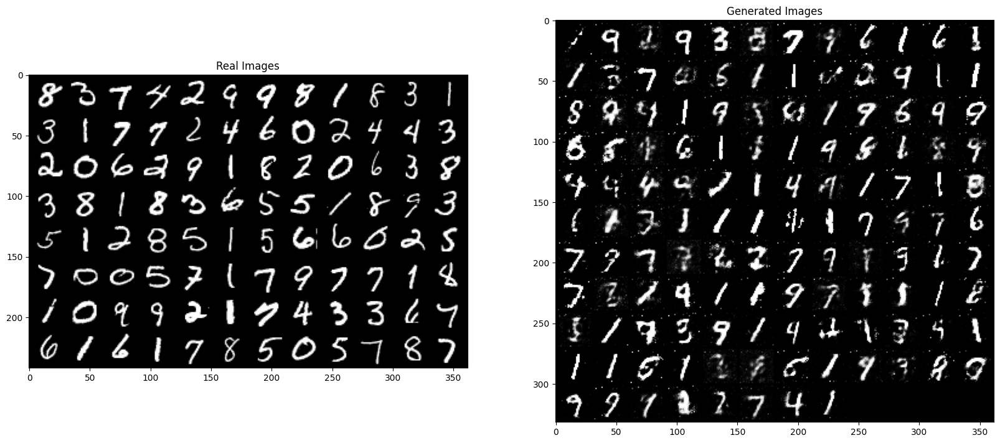

Epoch [38/50] Batch [0/469] Loss D: 0.9653329849243164, loss G: 1.3070220947265625
Epoch [38/50] Batch [100/469] Loss D: 1.1331589221954346, loss G: 1.5407556295394897
Epoch [38/50] Batch [200/469] Loss D: 0.938483715057373, loss G: 1.8533464670181274
Epoch [38/50] Batch [300/469] Loss D: 1.123422384262085, loss G: 1.2938849925994873
Epoch [38/50] Batch [400/469] Loss D: 0.687286376953125, loss G: 1.7744865417480469


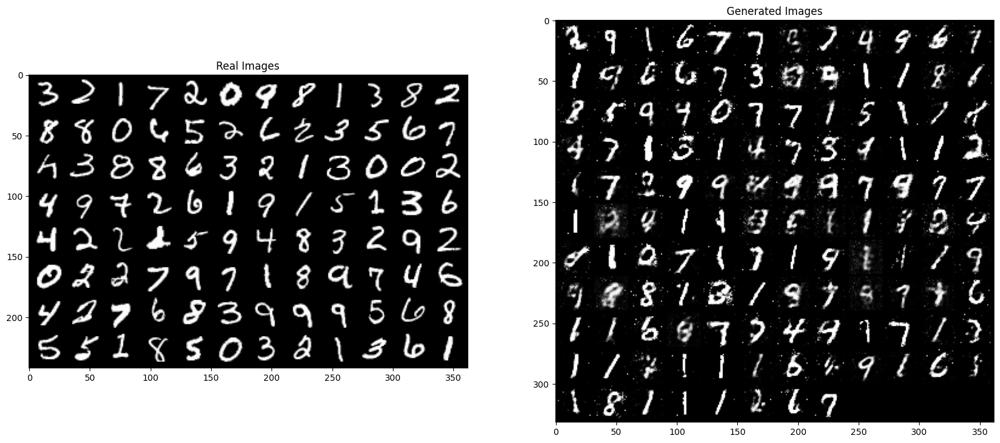

Epoch [39/50] Batch [0/469] Loss D: 0.7053066492080688, loss G: 1.8405979871749878
Epoch [39/50] Batch [100/469] Loss D: 1.0367040634155273, loss G: 1.1852895021438599
Epoch [39/50] Batch [200/469] Loss D: 1.0720677375793457, loss G: 1.358008861541748
Epoch [39/50] Batch [300/469] Loss D: 0.9255383014678955, loss G: 1.8816008567810059
Epoch [39/50] Batch [400/469] Loss D: 0.7699123620986938, loss G: 1.9082151651382446


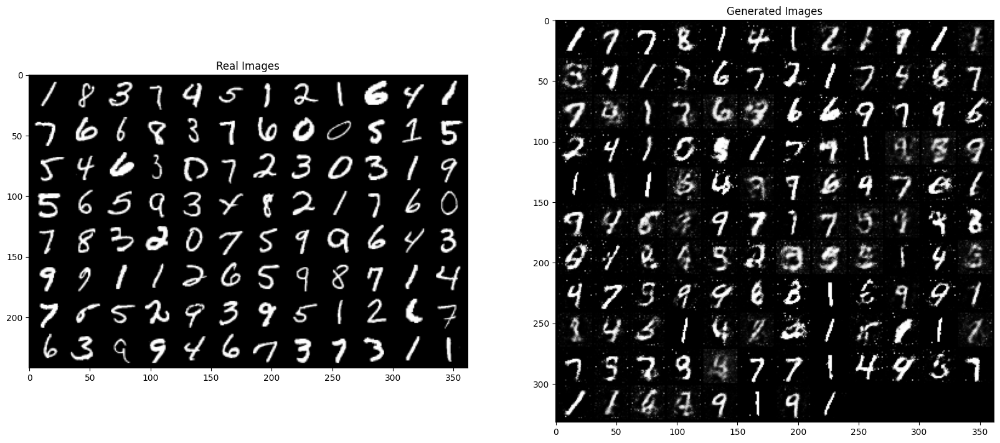

Epoch [40/50] Batch [0/469] Loss D: 0.667768120765686, loss G: 1.8323122262954712
Epoch [40/50] Batch [100/469] Loss D: 0.8815109729766846, loss G: 2.400756359100342
Epoch [40/50] Batch [200/469] Loss D: 1.0216845273971558, loss G: 1.4472942352294922
Epoch [40/50] Batch [300/469] Loss D: 0.9453085064888, loss G: 1.7375552654266357
Epoch [40/50] Batch [400/469] Loss D: 1.0604135990142822, loss G: 1.4105522632598877


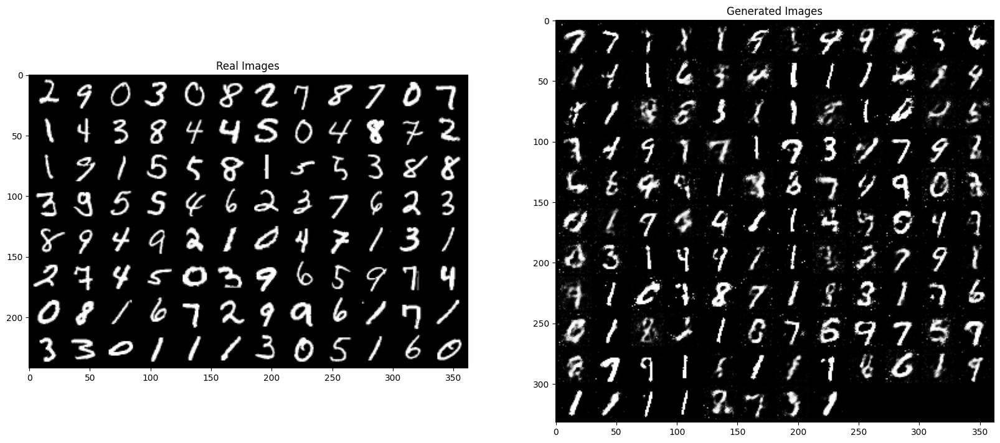

Epoch [41/50] Batch [0/469] Loss D: 0.8197581768035889, loss G: 1.660986065864563
Epoch [41/50] Batch [100/469] Loss D: 0.6538485288619995, loss G: 1.415419101715088
Epoch [41/50] Batch [200/469] Loss D: 0.887721598148346, loss G: 1.8083363771438599
Epoch [41/50] Batch [300/469] Loss D: 0.9625450968742371, loss G: 1.8896065950393677
Epoch [41/50] Batch [400/469] Loss D: 1.1333930492401123, loss G: 1.2564711570739746


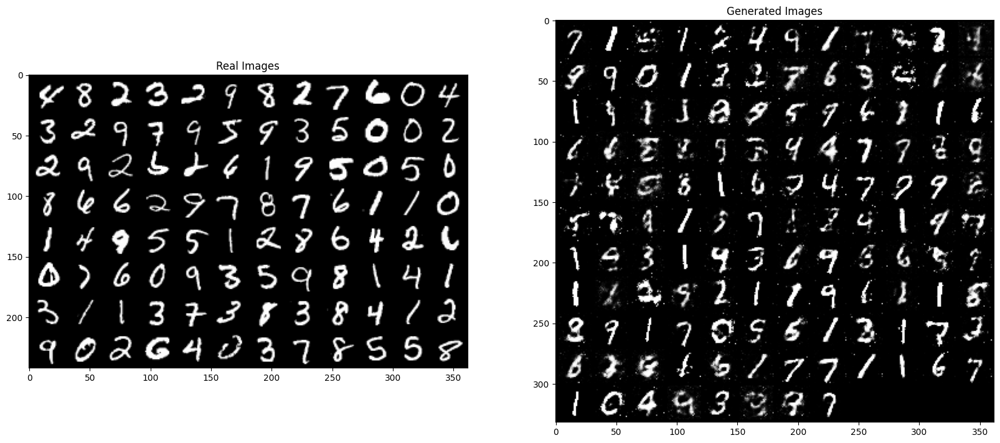

Epoch [42/50] Batch [0/469] Loss D: 0.8673978447914124, loss G: 1.3196001052856445
Epoch [42/50] Batch [100/469] Loss D: 0.8262654542922974, loss G: 1.6805012226104736
Epoch [42/50] Batch [200/469] Loss D: 0.9066951870918274, loss G: 1.4125335216522217
Epoch [42/50] Batch [300/469] Loss D: 0.6880944967269897, loss G: 1.687631368637085
Epoch [42/50] Batch [400/469] Loss D: 0.673499584197998, loss G: 1.5720860958099365


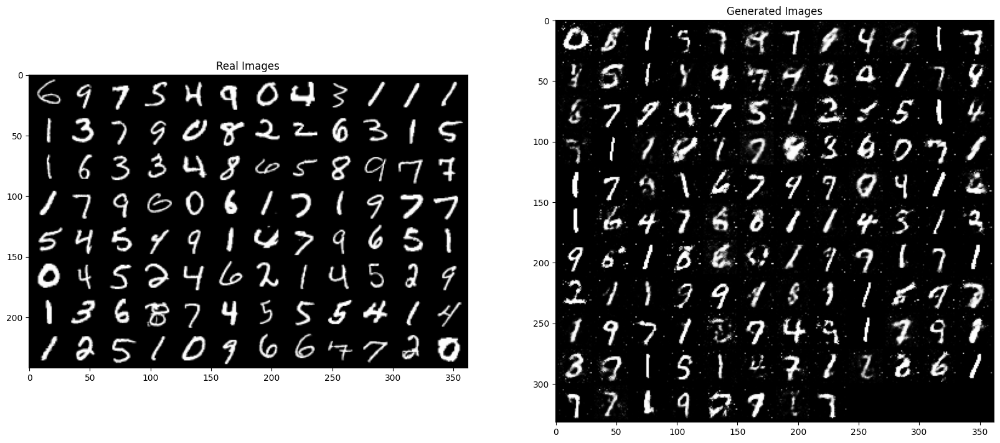

Epoch [43/50] Batch [0/469] Loss D: 0.8905950784683228, loss G: 1.8478407859802246
Epoch [43/50] Batch [100/469] Loss D: 0.88111412525177, loss G: 1.2528564929962158
Epoch [43/50] Batch [200/469] Loss D: 0.7861670851707458, loss G: 1.5428340435028076
Epoch [43/50] Batch [300/469] Loss D: 0.9041842222213745, loss G: 1.7698111534118652
Epoch [43/50] Batch [400/469] Loss D: 0.7143869400024414, loss G: 2.1869616508483887


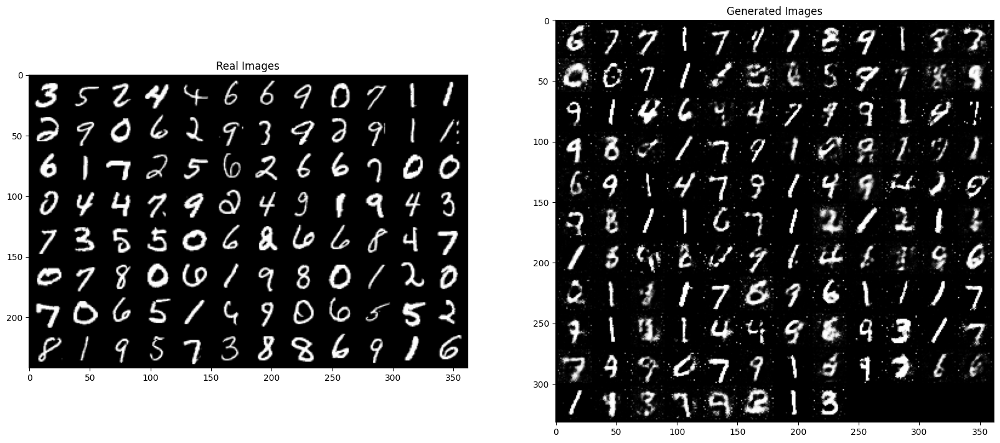

Epoch [44/50] Batch [0/469] Loss D: 0.8038790225982666, loss G: 1.6350332498550415
Epoch [44/50] Batch [100/469] Loss D: 0.8954727649688721, loss G: 1.3948683738708496
Epoch [44/50] Batch [200/469] Loss D: 0.9177981019020081, loss G: 1.530644416809082
Epoch [44/50] Batch [300/469] Loss D: 1.0300706624984741, loss G: 1.5129729509353638
Epoch [44/50] Batch [400/469] Loss D: 0.925360381603241, loss G: 1.2047724723815918


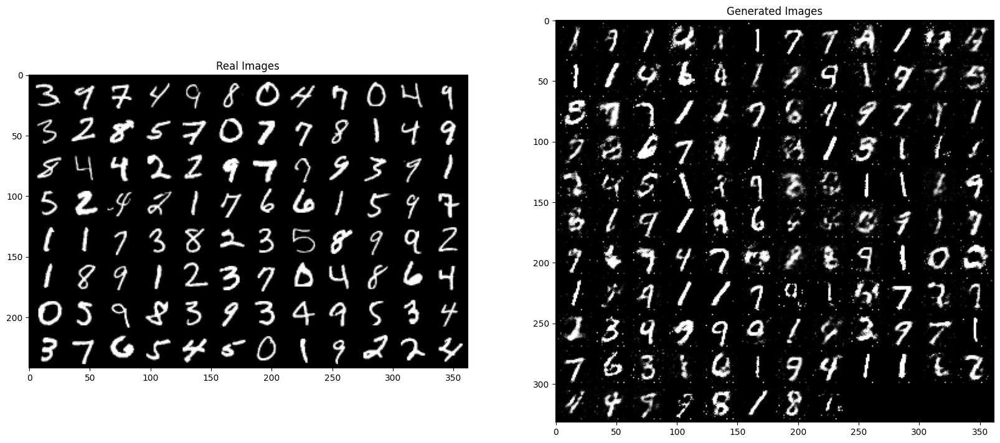

Epoch [45/50] Batch [0/469] Loss D: 0.9935364723205566, loss G: 1.6343140602111816
Epoch [45/50] Batch [100/469] Loss D: 0.7034273743629456, loss G: 1.9696955680847168
Epoch [45/50] Batch [200/469] Loss D: 0.51251220703125, loss G: 2.6702733039855957
Epoch [45/50] Batch [300/469] Loss D: 1.0268887281417847, loss G: 1.5363470315933228
Epoch [45/50] Batch [400/469] Loss D: 0.8746851086616516, loss G: 1.6921812295913696


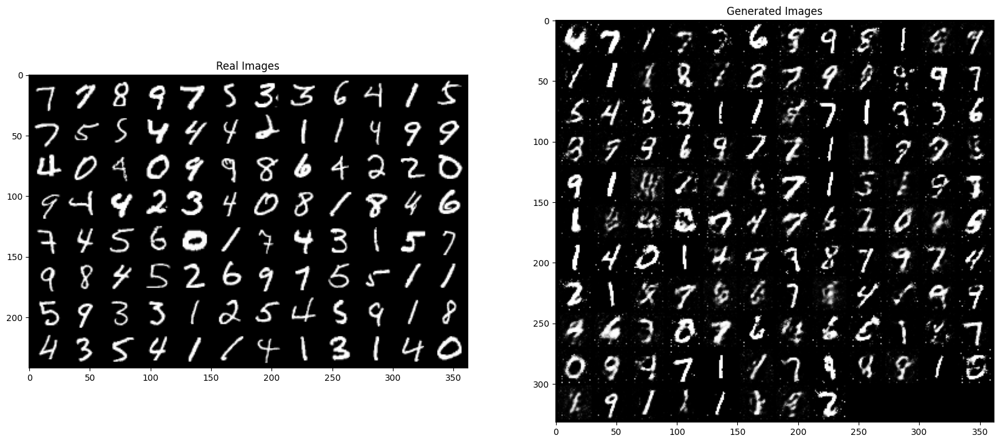

Epoch [46/50] Batch [0/469] Loss D: 0.8268505334854126, loss G: 1.5942569971084595
Epoch [46/50] Batch [100/469] Loss D: 0.5906683206558228, loss G: 1.9657361507415771
Epoch [46/50] Batch [200/469] Loss D: 0.8240479230880737, loss G: 1.4086694717407227
Epoch [46/50] Batch [300/469] Loss D: 1.3685271739959717, loss G: 1.2135716676712036
Epoch [46/50] Batch [400/469] Loss D: 0.8753826022148132, loss G: 1.469465970993042


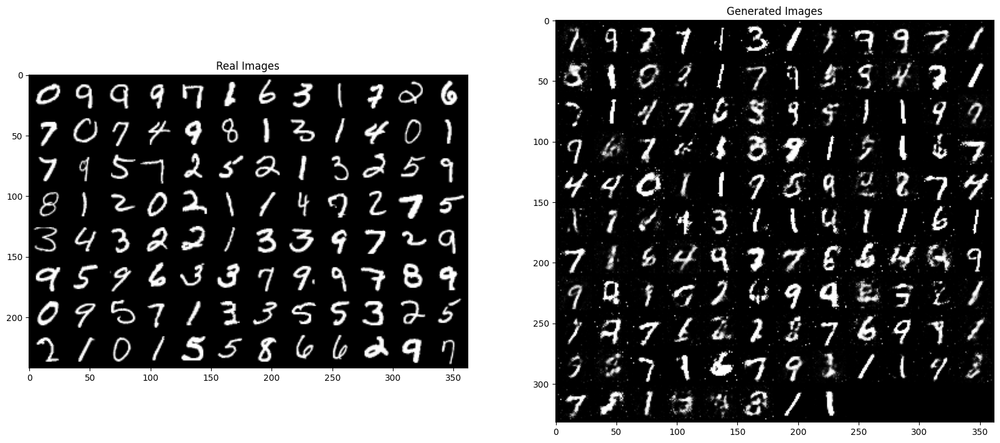

Epoch [47/50] Batch [0/469] Loss D: 0.8445938229560852, loss G: 1.1931668519973755
Epoch [47/50] Batch [100/469] Loss D: 1.028477668762207, loss G: 1.383984923362732
Epoch [47/50] Batch [200/469] Loss D: 0.8734639883041382, loss G: 1.812637448310852
Epoch [47/50] Batch [300/469] Loss D: 1.0503228902816772, loss G: 1.1503825187683105
Epoch [47/50] Batch [400/469] Loss D: 1.1708462238311768, loss G: 1.6224578619003296


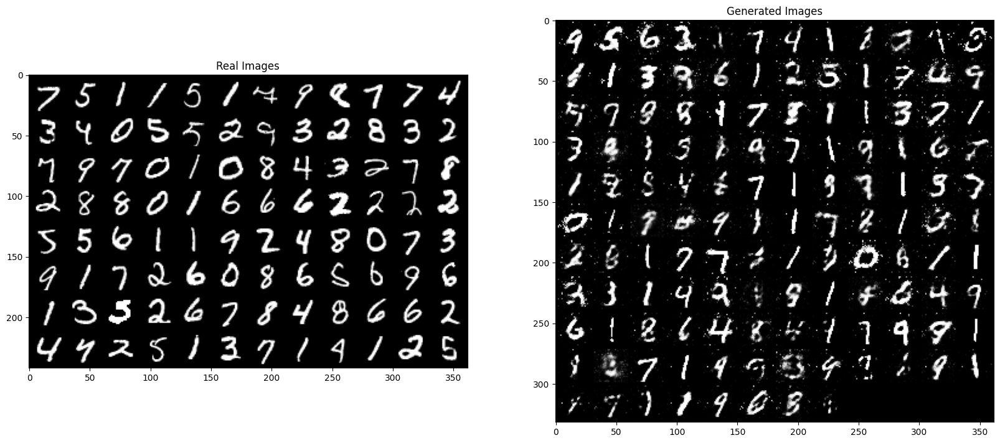

Epoch [48/50] Batch [0/469] Loss D: 0.7562537789344788, loss G: 1.620518684387207
Epoch [48/50] Batch [100/469] Loss D: 0.7069339752197266, loss G: 2.0889272689819336
Epoch [48/50] Batch [200/469] Loss D: 1.0004419088363647, loss G: 1.1861343383789062
Epoch [48/50] Batch [300/469] Loss D: 0.7143299579620361, loss G: 1.6754142045974731
Epoch [48/50] Batch [400/469] Loss D: 0.7954186201095581, loss G: 2.3806309700012207


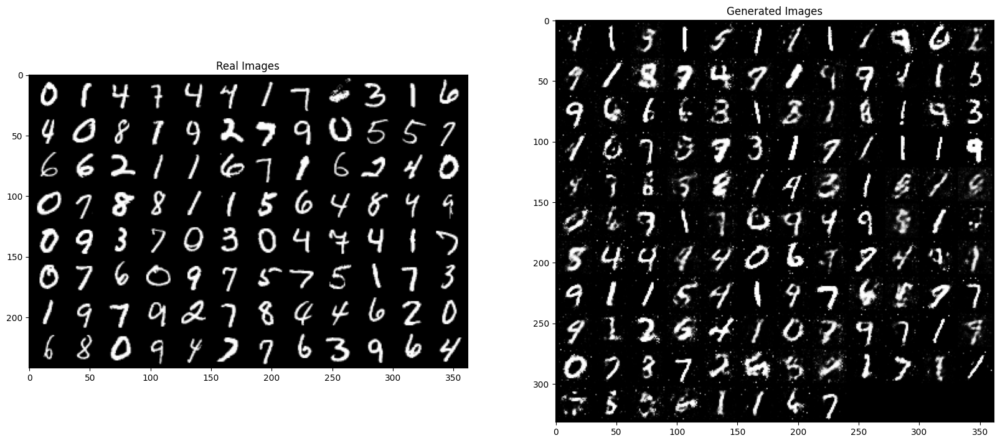

Epoch [49/50] Batch [0/469] Loss D: 1.120323896408081, loss G: 1.0673636198043823
Epoch [49/50] Batch [100/469] Loss D: 0.6671847105026245, loss G: 1.776953101158142
Epoch [49/50] Batch [200/469] Loss D: 1.1454248428344727, loss G: 1.6189422607421875
Epoch [49/50] Batch [300/469] Loss D: 0.7140496969223022, loss G: 1.5444015264511108
Epoch [49/50] Batch [400/469] Loss D: 0.7981622219085693, loss G: 1.8403676748275757


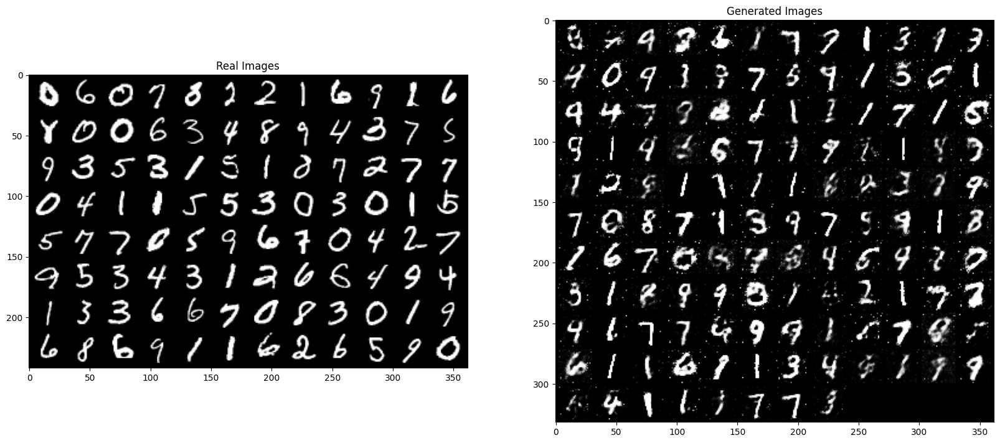

Epoch [50/50] Batch [0/469] Loss D: 1.2246201038360596, loss G: 1.0546824932098389
Epoch [50/50] Batch [100/469] Loss D: 0.8760688304901123, loss G: 1.5919771194458008
Epoch [50/50] Batch [200/469] Loss D: 0.8364279270172119, loss G: 1.658259391784668
Epoch [50/50] Batch [300/469] Loss D: 0.6513715386390686, loss G: 1.9176807403564453
Epoch [50/50] Batch [400/469] Loss D: 0.7897083163261414, loss G: 1.4334454536437988


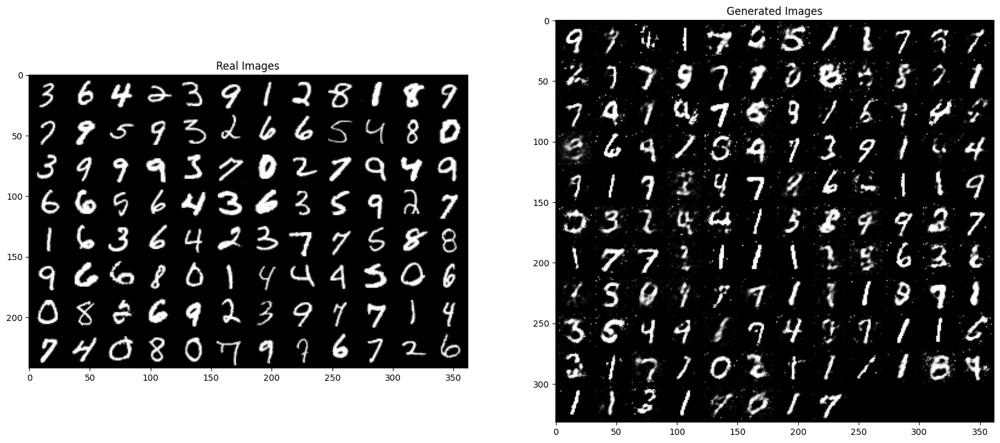

In [12]:
if __name__ == "__main__":
    train()

In [13]:
# Save the models
torch.save(G.state_dict(), 'generator.pth')
torch.save(D.state_dict(), 'discriminator.pth')